In [9]:
import os
import re

dir = '/mnt/data/Speech Dataset/IndicVoices/Punjabi/v1a'
train_dir = dir + '/train'
valid_dir = dir + '/valid'

# dir contains json and wav files with same name
# get all audio and their corresponding json files

def get_files(dir):
    audio_files = []
    for root, dirs, files in os.walk(dir):
        for file in files:
            if file.endswith('.wav'):
                audio_files.append(file)
    json_files = [file.replace('.wav', '.json') for file in audio_files]
    return audio_files, json_files

train_audio_files, train_json_files = get_files(train_dir)
valid_audio_files, valid_json_files = get_files(valid_dir)



In [10]:
test_str = 'ਕਮੀ ਆ ਲਾਈਟ ਨੀ ਆਉਂਦੀ ਤਾਂ ਪਾਣੀਆਂ ਦੂਈ [stammers] ਭਰਾ ਤੋਂ ਲੈਣਾ ਪੈਂਦਾ ਉਹਤੋਂ ਕੁਛ ਦੂਰ [ok no] ਆ ਪੈਂਦਾ ਉਸ [ok boy]ਤੋਂ ਪੈਪ ਵਿਛਾ ਕੇ ਲਿਆਓਗੇ[] ਲਾਉਣਾ [] ਪੈਂਦਾ'
cleaned_text = re.sub(r"\[.*?\]", "", test_str)
cleaned_text = re.sub(r"\s+", " ", cleaned_text).strip()
cleaned_text


'ਕਮੀ ਆ ਲਾਈਟ ਨੀ ਆਉਂਦੀ ਤਾਂ ਪਾਣੀਆਂ ਦੂਈ ਭਰਾ ਤੋਂ ਲੈਣਾ ਪੈਂਦਾ ਉਹਤੋਂ ਕੁਛ ਦੂਰ ਆ ਪੈਂਦਾ ਉਸ ਤੋਂ ਪੈਪ ਵਿਛਾ ਕੇ ਲਿਆਓਗੇ ਲਾਉਣਾ ਪੈਂਦਾ'

In [11]:
def combine_transcriptions(data, wav_file_path):
    combined_verbatim = []
    current_transcription = None

    for transcription in data["verbatim"]:
    
        transcription['text'] = re.sub(r"\[.*?\]", "", transcription["text"])
        transcription['text'] = re.sub(r"\s+", " ", transcription['text']).strip()
        
        if current_transcription is None:
            current_transcription = transcription
        else:
            # Check if the next transcription's start time minus the current transcription's end time
            # results in a combined duration of less than 30 seconds
            if transcription["end"] - current_transcription["start"] < 30:
                # Combine the transcriptions by updating the end time and appending the text
                current_transcription["end"] = transcription["end"]
                if current_transcription['text'].endswith('।') or transcription['text'].endswith('.'):
                    current_transcription["text"] += " " + transcription["text"]
                else:
                    current_transcription["text"] += "। " + transcription["text"]
            else:
                # If the combined duration is 30 seconds or more, append the current transcription to the combined list
                combined_verbatim.append((current_transcription["start"], current_transcription["end"], current_transcription["text"]))
                current_transcription = transcription

    # Don't forget to add the last transcription to the combined list if it wasn't added already
    if current_transcription is not None:
        combined_verbatim.append((current_transcription["start"], current_transcription["end"], current_transcription["text"]))

    return {
        "full_audio_filepath": wav_file_path,
        "gender": data["gender"],
        "speaker_id": data["speaker_id"],
        "transcriptions": combined_verbatim,
    }


In [12]:
import json

# get all the data from json files
def get_data(json_files, dir):
    dataset = []
    for json_file in json_files:
        with open(dir + '/' + json_file, 'r') as file:
            data = json.load(file)
            dataset.append(combine_transcriptions(data, json_file.replace('.json', '.wav')))
    return dataset

train_dataset = get_data(train_json_files, train_dir)
valid_dataset = get_data(valid_json_files, valid_dir)

print(len(train_dataset))
print(len(valid_dataset))


10049
54


In [13]:
train_dataset[0:5]

[{'full_audio_filepath': '5066549580813511.wav',
  'gender': 'Female',
  'speaker_id': 'S4257094700391012',
  'transcriptions': [(0.984,
    9.772,
    'ਟੈਪ ਐਂਡ ਪੇ ਵਿਧੀ ਲਈ ਮੇਰਾ ਡਿਫਾਲਟ ਕਾਰਡ ਬੈਂਕ ਔਫ ਮਹਾਰਾਸ਼ਟਰ ਰੁਪੇ ਕਾਰਡ ਤੋਂ ਪੁਡੂਵਾਈ ਭਰਥਿਆਰ ਗ੍ਰਾਮਾ ਬੈਂਕ ਕ੍ਰੈਡਿਟ ਕਾਰਡ ਕਰੋ')]},
 {'full_audio_filepath': '5066549580814329.wav',
  'gender': 'Female',
  'speaker_id': 'S4256889100320806',
  'transcriptions': [(0.446,
    4.857,
    'ਮੇਰੇ ਇੱਕ ਪੈਕ ਮਕੇਨ ਆਲੂ ਟਿੱਕੀ ਦੇ ਔਡਰ ਨੂੰ ਪੰਜ ਸਟਾਰ ਰੇਟਿੰਗ ਦਿਓ')]},
 {'full_audio_filepath': '5066549580798748.wav',
  'gender': 'Male',
  'speaker_id': 'S4259632200345724',
  'transcriptions': [(0.429,
    8.359,
    'ਕਿਹੜੀਆਂ ਉਨਿਵੇਰਸਿਟੀ ਪਰਬੰਧਿਤ ਸੰਸਥਾਵਾਂ ਏ ਆਈ ਸੀ ਟੀ ਈ ਦੁਆਰਾ ਪ੍ਰਵਾਨਿਤ ਹਨ?')]},
 {'full_audio_filepath': '5066549580814267.wav',
  'gender': 'Female',
  'speaker_id': 'S4259791000348797',
  'transcriptions': [(0.479, 1.457, 'ਅਗਲਾ')]},
 {'full_audio_filepath': '5066549580811223.wav',
  'gender': 'Male',
  'speaker_id': 'S4257128100377043',
  'transcriptions': [(0.734,

In [20]:
from datasets import Dataset, DatasetDict
from pydub import AudioSegment
from datasets import Dataset, Features, ClassLabel, Value, Audio
import pandas as pd

def split_audio(data_item, dir_split, split):
    audio_chunks = []
    audio = AudioSegment.from_wav(f'{dir}/{split}/{data_item['full_audio_filepath']}')
    for i, (start, end, text) in enumerate(data_item['transcriptions']):
        start_ms = start * 1000
        end_ms = end * 1000
        audio_chunk = audio[start_ms:end_ms]
        chunk_filename = f"{data_item['full_audio_filepath'].replace('.wav', '')}_{i}.wav"
        
        audio_file_path = f'{dir}/{dir_split}/{chunk_filename}'
        audio_chunk.export(audio_file_path, format="wav")

        d = {
            'audio': audio_file_path,
            'text': text,
            'speaker_id': data_item['speaker_id'],
            'gender': data_item['gender'].lower()
        }

        audio_chunks.append(d) 

    return audio_chunks


def get_audio_chunks(dataset, dir_split, split):
    audio_chunks = []
    for data_item in dataset:
        audio_chunks.extend(split_audio(data_item, dir_split, split))
    return audio_chunks

train_audio_chunks = get_audio_chunks(train_dataset, 'train_chunks', 'train')
valid_audio_chunks = get_audio_chunks(valid_dataset, 'valid_chunks', 'valid')

print(len(train_audio_chunks))
print(len(valid_audio_chunks))



17366
95


In [21]:
t = Dataset.from_list(train_audio_chunks)
v = Dataset.from_list(valid_audio_chunks)
print(t)
print(v)



Dataset({
    features: ['audio', 'text', 'speaker_id', 'gender'],
    num_rows: 17366
})
Dataset({
    features: ['audio', 'text', 'speaker_id', 'gender'],
    num_rows: 95
})


In [22]:
t = t.cast_column("audio", Audio(sampling_rate=16000))
v = v.cast_column("audio", Audio(sampling_rate=16000))
print(t)
print(t[0])


Dataset({
    features: ['audio', 'text', 'speaker_id', 'gender'],
    num_rows: 17366
})
{'audio': {'path': '/mnt/data/Speech Dataset/IndicVoices/Punjabi/v1a/train_chunks/5066549580813511_0.wav', 'array': array([ 0.01145675,  0.01906523,  0.01672884, ..., -0.0150966 ,
       -0.01381147,  0.        ]), 'sampling_rate': 16000}, 'text': 'ਟੈਪ ਐਂਡ ਪੇ ਵਿਧੀ ਲਈ ਮੇਰਾ ਡਿਫਾਲਟ ਕਾਰਡ ਬੈਂਕ ਔਫ ਮਹਾਰਾਸ਼ਟਰ ਰੁਪੇ ਕਾਰਡ ਤੋਂ ਪੁਡੂਵਾਈ ਭਰਥਿਆਰ ਗ੍ਰਾਮਾ ਬੈਂਕ ਕ੍ਰੈਡਿਟ ਕਾਰਡ ਕਰੋ', 'speaker_id': 'S4257094700391012', 'gender': 'female'}


In [23]:
ds = DatasetDict({
    'train': t,
    'valid': v
})

In [24]:
ds.save_to_disk('/mnt/data/Speech Dataset/IndicVoices/Punjabi/v1a/indicvoice_pa_ds')

Saving the dataset (0/45 shards):   0%|          | 0/17366 [00:00<?, ? examples/s]

Saving the dataset (0/1 shards):   0%|          | 0/95 [00:00<?, ? examples/s]

In [ ]:
ds.push_to_hub('kdcyberdude/indicvoice_pa_ds')

In [41]:


from datasets import load_from_disk, concatenate_datasets
from pydub import AudioSegment

ds = load_from_disk('/mnt/data/Speech Dataset/IndicVoices/Punjabi/v1a/indicvoice_pa_ds')
print(ds)


Loading dataset from disk:   0%|          | 0/45 [00:00<?, ?it/s]

DatasetDict({
    train: Dataset({
        features: ['audio', 'text', 'speaker_id', 'gender'],
        num_rows: 17366
    })
    valid: Dataset({
        features: ['audio', 'text', 'speaker_id', 'gender'],
        num_rows: 95
    })
})


In [42]:
ds_valid = ds['valid']
ds_valid

Dataset({
    features: ['audio', 'text', 'speaker_id', 'gender'],
    num_rows: 95
})

In [45]:

def update_ds(batch):
    gender_list = batch['gender']
    sampling_rate = 16000
    audio_array_list = batch['audio']

    gender_list = ['m' if x == 'male' else 'f' for x in gender_list]
    durations = [len(x['array']) / sampling_rate for x in audio_array_list]
        
    batch['gender'] = gender_list
    batch['duration'] = durations
    return batch

total_rows = len(ds_valid)
split_size = 2000
num_shards = total_rows // split_size
if num_shards == 0:
    num_shards = 1
print(f'Number of shards: {num_shards}')
num_proc = 24
shards = []
for i in range(num_shards):
    shard = ds_valid.shard(num_shards, i, contiguous=True)
    print(f'Processing shard {i} with {len(shard)} rows')
    shard = shard.map(update_ds, num_proc=num_proc, batched=True, batch_size=split_size//num_proc)
    shards.append(shard)



Number of shards: 1
Processing shard 0 with 95 rows


Map (num_proc=24):   0%|          | 0/95 [00:00<?, ? examples/s]

In [7]:
len(ds)

17366

In [46]:
ds_concat = concatenate_datasets(shards)
print(ds_concat)

Dataset({
    features: ['audio', 'text', 'speaker_id', 'gender', 'duration'],
    num_rows: 95
})


In [9]:
ds_concat[0]

{'audio': {'path': None,
  'array': array([ 0.01144409,  0.01904297,  0.01672363, ..., -0.0151062 ,
         -0.01382446,  0.        ]),
  'sampling_rate': 16000},
 'text': 'ਟੈਪ ਐਂਡ ਪੇ ਵਿਧੀ ਲਈ ਮੇਰਾ ਡਿਫਾਲਟ ਕਾਰਡ ਬੈਂਕ ਔਫ ਮਹਾਰਾਸ਼ਟਰ ਰੁਪੇ ਕਾਰਡ ਤੋਂ ਪੁਡੂਵਾਈ ਭਰਥਿਆਰ ਗ੍ਰਾਮਾ ਬੈਂਕ ਕ੍ਰੈਡਿਟ ਕਾਰਡ ਕਰੋ',
 'speaker_id': 'S4257094700391012',
 'gender': 'f',
 'durations': 8.7880625}

In [11]:
d = ds_concat['durations']


Text(0.5, 1.0, 'Audio length distribution in seconds')

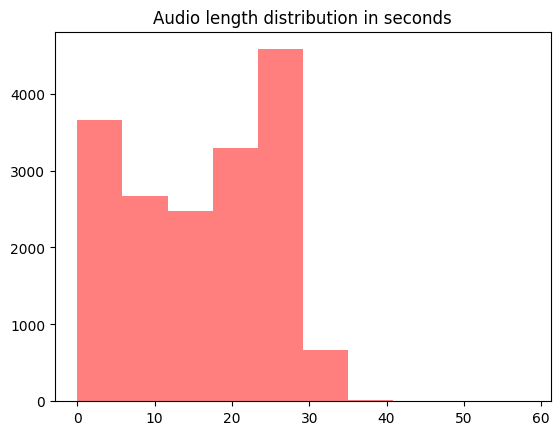

In [12]:
import pylab as plt

# plt.hist(ds['train']['duration'], color='blue', alpha=0.5, label='train')
plt.hist(d, color='red', alpha=0.5, label='valid')
plt.title('Audio length distribution in seconds')

In [16]:
len(d)

17366

In [20]:
# count values greater than 30
print(sum([1 for x in d if x > 30]))

66


In [26]:
# get indexes of values greater than 30
indexes = [i for i, x in enumerate(d) if x > 30]
print(indexes)

[1200, 1725, 2460, 2462, 2536, 2591, 2592, 3181, 3182, 3184, 3187, 3188, 3190, 3216, 3347, 3553, 4572, 4575, 4620, 4621, 4769, 5368, 5405, 5468, 5470, 6096, 6607, 6608, 7149, 7327, 7458, 7736, 7752, 8048, 8053, 8055, 8760, 8806, 9119, 9121, 9398, 9490, 9640, 9641, 10014, 10096, 10280, 10370, 10631, 11605, 11635, 12228, 13222, 13300, 13489, 13788, 14030, 14355, 15045, 15079, 15376, 16071, 16344, 16346, 16395, 17058]


In [23]:
dss = ds_concat.select(indexes)
# display audio
import IPython.display as ipd
ipd.Audio(dss[0]['audio']['array'], rate=16000)

In [24]:
ipd.Audio(dss[1]['audio']['array'], rate=16000)

In [25]:
ipd.Audio(dss[2]['audio']['array'], rate=16000)

In [28]:
# remove indexes greater than 30
ds_concat[17366-1]

{'audio': {'path': None,
  'array': array([ 0.00405884,  0.00857544,  0.01031494, ..., -0.00787354,
         -0.01062012, -0.00991821]),
  'sampling_rate': 16000},
 'text': 'ਆਂਧਰਾ ਪ੍ਰਦੇਸ਼ ਅਰੁਣਾਚਲ ਪ੍ਰਦੇਸ਼ ਅਸਮ ਬਿਹਾਰ ਛੱਤੀਸਗੜ੍ਹ',
 'speaker_id': 'S4258578900304444',
 'gender': 'm',
 'durations': 5.927}

In [29]:
# get all the indexes for the ds and remove indexes list
indexes_all = list(range(17366))
indexes_all = [x for x in indexes_all if x not in indexes]
print(len(indexes_all))

17300


In [30]:
len(ds) - len(indexes_all)

66

In [31]:
ds_filtered = ds_concat.select(indexes_all)
print(ds_filtered)

Dataset({
    features: ['audio', 'text', 'speaker_id', 'gender', 'durations'],
    num_rows: 17300
})


In [34]:
ds_filtered

Dataset({
    features: ['audio', 'text', 'speaker_id', 'gender', 'durations'],
    num_rows: 17300
})

In [36]:
from datasets import DatasetDict

In [47]:
print(ds_filtered)
print(ds_concat)

Dataset({
    features: ['audio', 'text', 'speaker_id', 'gender', 'durations'],
    num_rows: 17300
})
Dataset({
    features: ['audio', 'text', 'speaker_id', 'gender', 'duration'],
    num_rows: 95
})


In [48]:
# save to disk
ds = DatasetDict({
    'train': ds_filtered,
    'valid': ds_concat
})

print(ds)

DatasetDict({
    train: Dataset({
        features: ['audio', 'text', 'speaker_id', 'gender', 'durations'],
        num_rows: 17300
    })
    valid: Dataset({
        features: ['audio', 'text', 'speaker_id', 'gender', 'duration'],
        num_rows: 95
    })
})


In [ ]:
ds.save_to_disk('/mnt/data/Speech Dataset/processed_datasets/indicvoice_pa_ASR')

In [1]:
from datasets import load_from_disk

ds = load_from_disk('/mnt/data/Speech Dataset/processed_datasets/indicvoice_pa_ASR')
ds

Loading dataset from disk:   0%|          | 0/18 [00:00<?, ?it/s]

DatasetDict({
    train: Dataset({
        features: ['audio', 'text', 'speaker_id', 'gender', 'durations'],
        num_rows: 17300
    })
    valid: Dataset({
        features: ['audio', 'text', 'speaker_id', 'gender', 'duration'],
        num_rows: 95
    })
})

In [2]:
# rename durations to duration in train
ds['train'] = ds['train'].rename_column('durations', 'duration')
ds

DatasetDict({
    train: Dataset({
        features: ['audio', 'text', 'speaker_id', 'gender', 'duration'],
        num_rows: 17300
    })
    valid: Dataset({
        features: ['audio', 'text', 'speaker_id', 'gender', 'duration'],
        num_rows: 95
    })
})

In [4]:
ds.save_to_disk('/mnt/data/Speech Dataset/processed_datasets/Indicvoice_pa_ASR', num_proc=24)

Saving the dataset (0/24 shards):   0%|          | 0/17300 [00:00<?, ? examples/s]

Saving the dataset (0/24 shards):   0%|          | 0/95 [00:00<?, ? examples/s]

In [1]:


from datasets import load_from_disk
ds = load_from_disk('/mnt/data/Speech Dataset/processed_datasets/Indicvoice_pa_ASR')
ds

Loading dataset from disk:   0%|          | 0/24 [00:00<?, ?it/s]

Loading dataset from disk:   0%|          | 0/24 [00:00<?, ?it/s]

DatasetDict({
    train: Dataset({
        features: ['audio', 'text', 'speaker_id', 'gender', 'duration'],
        num_rows: 17300
    })
    valid: Dataset({
        features: ['audio', 'text', 'speaker_id', 'gender', 'duration'],
        num_rows: 95
    })
})

In [2]:
import IPython.display as ipd
from IPython.display import Audio

def display_audio(row):
    print(row['text'])
    return Audio(row['audio']['array'], rate=16000, autoplay=True)
# sort by length of text
ds_check = sorted(ds['train'], key=lambda x: len(x['text']), reverse=True)
for i in range(20):
    r = display_audio(ds_check[i])
    ipd.display(r)

ਖੇਤੀ ਕਰਨ ਵਾਸਤੇ ਸਰਕਾਰ ਨੂੰ ਜਿਹੜਾ ਕ੍ਰੈਡਿਟ ਲੋਨ ਜਿੱਦਾਂ ਹੁਣ ਆਪਾਂ ਦੇਖਿਆ ਜਾਵੇ ਜਿਹੜਾ ਮੈਡਵਲ ਹਿਸਟੀ ਹੈ ਜਾਂ ਕੁਛ ਵੀ ਹੈਗਾ ਏ ਉਹਦੇ ਵਿੱਚ ਸਾਰਾ ਕੁਛ ਜਿਹੜੀਆਂ ਕੋਈ ਵੀ ਜਿਹੜਾ। ਭਾ ਭਾਰਤ ਦਾ ਰਾਜਾ ਹੋਇਆ ਹੈਗਾ ਉਹ ਖੇਤੀ ਕਰਨ ਵਾਸਤੇ ਜਿਹੜੇ ਲੋਕਾਂ ਨੂੰ ਹੈਗਾ ਏ ਉਹਦਾ ਮੇਨ ਸੋਰਸ ਕਿਆ ਹੁੰਦਾ ਤਾ ਉਹਦਾ ਮੇਨ ਸੋਰਸ ਹੁੰਦਾ ਸੀਗਾ। ਐਗਰੀਕਲਚਰ ਐਗਰੀਕਲਚਰ ਜਿਹੜਾ ਜਿਹੜੇ ਕਿਸਾਨ ਹੁੰਦੇ ਸੀਗੇ ਉਹਨਾਂ ਨੂੰ ਉਹ ਕ੍ਰੈਡਿਟ ਲੋਨ ਪ੍ਰੋਵਾਈਡ ਕਰਦਾ ਸੀਗਾ ਸਿਰਫ਼ ਉਹ ਖੇਤੀ ਦੇ ਨਾਂ ਤੇ ਲੋਨ ਦੇ ਦਿੰਦੇ ਸੀਗੇ ਬਾਅਦ ਚ ਉਹਦੇ ਤੋਂ ਉਹ ਕਿਸਤਾਂ ਦੇ ਰੂਪ ਵਿੱਚ ਉਹਦੇ ਤੋਂ ਲੈ ਲਿਆ ਜਾਂਦਾ ਸੀਗਾ ਇਸ ਤਰ੍ਹਾਂ ਜਿਹੜੇ ਪੰਜਾਬ ਸਰਕਾਰ ਐ। ਉਹਨਾਂ ਨੂੰ ਵੀ ਮਤਲਬ ਖੇਤੀ ਦੇ ਵਿੱਚ ਕ੍ਰੈਡਿਟ ਲੋਨ ਦੀ ਜਿਹੜੀ ਹੈਗੀ ਐ ਸੁਵਿਧਾਵਾਂ ਵਗੈਰਾ ਤੇ ਇਹ ਤੋਂ ਇਲਾਵਾ ਹੋਰ ਵੀ ਜਿਹੜੇ ਸੰਦ ਵੱਟੇ ਆ ਉਨ੍ਹਾਂ ਦੇ


ਜਦੋਂ ਉਹਦੀ ਨਾਈਟ੍ਰੋਨਜ ਦੀ ਮਾਤਰਾ ਜਿਹੜੀ ਐ ਘੱਟਣ ਲੱਗ ਪੈਂਦੀ ਹੈਗੀ ਐ ਤਾਂ ਉਹ ਜਿਹੜੇ ਜਿਹੜੀ ਉਸ ਵਿੱਚ ਜਿਹੜਾ ਜਿਹੜੀ ਚੀਜ਼ ਪੈਦਾ ਹੁੰਦੀ ਹੈਗੀ ਐ ਇੱਕ ਤਾਂ ਕਹਿੰਦੇ ਹੈਗੇ ਜਿੱਦਾਂ ਆਪਾਂ ਬੰਦਿਆਂ ਨੂੰ ਕੈਂਸਰ ਹੋ ਗਿਆ ਤਾਂ ਅਸੀਂ ਇੱਕ ਐਦਾਂ ਹੁਣ ਹੁਣ ਇਹ ਵੀ ਸੁਣਨ ਚ ਆਣ ਲੱਗ ਪਿਆ ਵੀ ਜਮੀਨ ਨੂੰ ਵੀ ਕੈਂਸਰ ਹੋ ਗਿਆ। ਤਾਂ ਇਦਾਂ ਦੀਆਂ ਜਿਹੜੀਆਂ ਹੇਇਆਂ ਏ ਉਹ ਸਾਨੂੰ ਸਾਹਮਣਾ ਆਉਂਦੇ ਹੈਗੇ ਸਾਡਾ ਨਤੀਜੇ ਸਾਰਾ ਕੁਛ ਇਦਾਂ ਦੀਆਂ ਮਤਲਬ ਆਣਾ ਸ਼ੁਰੂ ਹੋ ਗਿਆ ਵਾ ਹੈਗਾ ਐ ਇਸ ਤਰ੍ਹਾਂ ਆਪਾਂ ਜੇ ਰਲਾ ਮਿਲਾ ਕੇ ਦੇਖਿਆ ਜਾਵੇ ਤਾਂ ਜਿਹੜੇ ਜਿਹੜੀ ਕੀਟਨਾਸ਼ਕ ਜਿਹੜੀ ਵੀ ਦਵਾਈਆਂ ਮਤਲਬ ਸ਼ੁਰੂ ਚ ਤਾਂ ਇਹ ਮਤਲਬ ਮਿੱਟੀ ਤੇ ਪੈਦਾਵਰ ਜਿਹੜੀਆਂ ਹੈਗੀਆਂ ਫਸਲਾਂ ਦੀ ਪੈਦਾਵਾਰ ਨੂੰ ਵਧਾਉਣ ਵਾਸਤੇ ਇਹਨਾਂ ਦਾ ਯੂਜ਼ ਕੀਤਾ ਗਿਆ ਸੀਗਾ ਪਰ ਅੱਜ ਕੱਲ੍ਹ ਇਹਨਾਂ ਦਾ ਯੂਜ਼


ਦੇਖਿਆ ਜਾਵੇ ਤਾਂ ਸਾਡੀ ਰਸੋਈ ਵਿੱਚ ਬਹੁਤ ਤਰੀਕੇ ਦੇ ਬਰਤਨ ਹੁੰਦੇ ਹਨ ਜਿਵੇਂ ਕੀ ਚਾਹ ਵਾਲਾ ਉਸਦੇ ਵਿੱਚ ਅਸੀਂ ਚਾਹ ਬਣਾਉਦੇ ਹਾਂ ਕਈਆਂ ਦੇ ਘਰਾਂ ਵਿੱਚ ਛੋਟੇ ਚਾਹ ਵਾਲੇ ਹੁੰਦੇ ਹਨ ਕਈਆਂ ਦੇ ਵਿੱਚ ਬੜੇ ਹੁੰਦੇ ਹਨ ਜਿਸ ਵਿੱਚ ਦੁੱਧ ਵੀ ਗਰਮ ਕਰ ਸਕਦੇ ਹਨ ਤੇ ਰਹੀ ਗੱਲ ਕੋ ਇੱਕ ਉਸਦੇ ਵਿੱਚ ਕੁੱਕਰ ਆਉਦਾ ਹੈ ਪਹਿਲਾਂ ਕਿਯਾ ਹੁੰਦਾ ਸੀ ਲੋਕੀ ਪਤੀਲੇ ਵਿੱਚ ਦਾਲਾਂ ਦੂਲਾਂ ਬਣਾਉਦੇ ਸੀ ਉਹਦੇ ਵਿੱਚ ਟਾਈਮ ਬਹੁਤ ਜ਼ਿਆਦਾ ਲੱਗਦਾ ਸੀਗਾ ਪਰ ਅੱਜ ਕੱਲ੍ਹ ਕੁੱਕਰ ਆਗਿਆ ਹੈ ਜਿਹਦੇ ਵਿੱਚ ਆਪਾਂ ਸਬਜ਼ੀ ਸੁਬਜ਼ੀ ਛੋਲੇ ਵਗੈਰਾ ਕੁਛ ਵੀ ਬਣਾਈਏ ਤਾਂ ਇੱਕ ਦੋ ਸੀਟੀਆਂ ਦੇ ਵਿੱਚ ਹੀ ਸਾਡਾ ਕੰਮ ਬਣ ਜਾਂਦਾ ਹੈ। ਤੇ ਦੂਜੀ ਗੱਲ ਇਸਤੋਂ ਬਾਅਦ ਹੁਣ ਅੱਜ ਕੱਲ੍ਹ ਦੇ ਜ਼ਮਾਨੇ ਵਿੱਚ ਨੋਨਸਟਿਕ ਸਮਾਨ ਜ਼ਿਆਦਾ ਆਗਿਆ ਹੈ ਨੋਨਸਟਿਕ ਭਾਂਡੇ ਆ ਗਏ ਹਨ


ਪਹਿਤ ਸਾਡੇ ਜਿਹੜੇ ਧਾਰਮਿਕ ਤਿਉਹਾਰ ਹੈਗੇ ਐ ਉਹਨਾਂ ਨਾਲ ਸੰਬੰਧਿਤ ਬਹੁਤ ਸਾਰੇ ਖਾਣੇ ਬਣਾਏ ਜਾਂਦੇ ਹੈਗੇ ਐ ਉਹਨਾਂ ਵਿੱਚ ਜਿਹੜਾ ਸਭ ਤੋਂ ਮੇਨ ਖਾਣਾ ਹੁੰਦਾ ਹੈਗਾ ਜਿੱਦਾਂ ਹੁਣ ਮੰਨ ਲੋ। ਸਾਡੇ ਜਿਹੜਾ ਕਿਤੇ ਵੀ ਅਖੰਡ ਪਾਠ ਸਾਹਿਬ ਜਾਂ ਕੋਈ ਵੀ ਤਿਉਹਾਰ ਆਉਂਦਾ ਹੈਗਾ ਸਭ ਤੋਂ ਪਹਿਲਾਂ ਤਾਂ ਉੱਥੇ ਦੇਗ ਬਣਾਈ ਜਾਂਦੀ ਹੈਗੀ ਐ ਦੇਗ ਦਾ ਭੋਗ ਲਵਾਇਆ ਜਾਂਦਾ ਹੈਗਾ ਏ ਦੇਗ ਸਾਡਾ ਪ੍ਰਮੁੱਖ ਖਾਣਾ ਹੈਗਾ ਏ ਉਹਤੇ ਬਾਅਦ ਜਦੋਂ ਲੰਗਰ ਚੱਲਦੇ ਹੈਗੇ ਐ ਉੱਥੇ ਜਿਹੜੀ ਦਾਲ ਬਣਾਈ ਜਾਂਦੀ ਹੈਗੀ ਐ ਉਹਨੂੰ ਉੱਥੇ ਲੰਗਰ ਦੀ ਦਾਲ ਵੀ ਕਿਹਾ ਜਾਂਦਾ ਹੈਗਾ ਐ ਦਾਲ ਫੁਲਕਾ ਵਗੈਰਾ ਵੀ ਚੱਲਦਾ ਹੈਗਾ ਏ ਉਹ ਤੇ ਇਲਾਵਾ ਜਿਦਾਂ ਲੰਗਰਾਂ ਵਿੱਚ ਸਾਡੇ ਉੱਥੇ ਦੁੱਧ ਵਗੈਰਾ ਵੀ ਚੱਲਦਾ ਹੁੰਦਾ ਹੈਗਾ ਏ ਦੁੱਧ ਚਾਹ ਵਗੈਰਾ ਵੀ ਚੱਲਦਾ ਰਹਿੰਦਾ ਹੈਗਾ ਏ


ਉਹਦੇ ਵਾਸਤੇ ਐੱਮ ਐੱਸ ਪੀ ਹੁੰਦਾ ਮਿਨੀਅਮ ਸੈਲਿੰਗ ਪ੍ਰਾਈਜ਼ ਮਤਲਬ ਸਭ ਤੋਂ ਕ ਮਤਲਬ ਪਹਿਲਾਂ ਕੋਈ ਵੀ ਫ਼ਸਲ ਦਾ ਸਾਨੂੰ ਮਿਨੀਅਮ ਸੈਲਿੰਗ ਪ੍ਰਾਈਜ਼ ਸਾਨੂੰ ਪ੍ਰੋਵਾਈਡ ਕਰਵਾਉਣਾ ਉਹਦੇ ਵਾਸਤੇ ਸਾਨੂੰ ਇੱਕ ਜਿੱਦਾਂ ਮਤਲਬ ਕੋਈ ਵੀ ਫ਼ਸਲ ਬੀਜਦੇ ਉਹਦੇ ਸਾਨੂੰ ਪਤਾ ਲੱਗ ਜਾਂਦਾ ਕਿ ਵੀ ਫ਼ਸਲ ਸਾਡੀ ਜਿਹੜੀ ਹੈਗੀ ਆ ਉਹ ਇੰਨੇ ਕ ਰੇਟ ਤੇ ਚਲ ਜਾਣੀ ਹੈਗੀ ਏ ਨਹੀਂ ਵਿੱਚ ਦਲਾਲ ਪੈ ਕੇ ਜਿਹੜਾ ਫਸਲਾਂ ਦੇ ਰੇਟ ਐ ਉਹ ਉੱਪਰ ਥੱਲਾ ਹੁੰਦੇ ਰਹਿੰਦੇ ਹੈਗੇ ਇਹਦੇ ਨਾਲ ਜਿਹੜਾ ਕਿਸਾਨ ਨੂੰ ਐ ਕਾਫ਼ੀ ਘਾਟਾ ਪੈ ਜਾਂਦਾ ਹੈਗਾ ਏ। ਉਹਤੋਂ ਇਲਾਵਾ ਜਿਹੜੀਆਂ ਜਿਹੜੀਆਂ ਮਤਲਬ ਸਰਕਾਰਾਂ ਏ ਇਹਤੇ ਇਲਾਵਾ ਹੋਰ ਕਿਆ ਕੰਮ ਕਰ ਸਕਦੀਆਂ ਇਹਤੇ ਇਲਾਵਾ ਜਿਹੜੀਆਂ ਸਰਕਾਰਾਂ ਹੈਗੀਆਂ ਜਿੱਦਾਂ ਹੁਣ ਕੋਈ ਬੰਦਾ ਮੰਨ ਲੋ ਖੇਤੀ ਕਰਦਾ ਹੈਗਾ ਏ


ਆਪਣੇ ਪਿਤਾ ਜੀ ਨੂੰ ਕੁਰਬਾਨੀ ਦੇਣ ਲਈ ਪ੍ਰੇਰਿਆ ਇਹ ਤੋਂ ਇਲਾਵਾ ਹੋਰ ਵੀ ਸ਼੍ਰੀ ਗੁਰੂ ਗੋਬਿੰਦ ਸਿੰਘ ਜੀ ਨੇ ਜਿਹੜੇ ਵੀ ਕੰਮ ਕੀਤੇ ਤਾਂ ਉਹਨਾਂ ਬਾਰੇ ਨਾ ਤਾਂ ਸਾਨੂੰ ਡੀਪਲੀ ਪੜ੍ਹਾਇਆ ਜਾਂਦਾ ਤੇ ਨਾ ਉਹਨਾਂ ਬਾਰੇ ਦੱਸਿਆ ਜਾਂਦਾ ਹੈਗਾ ਏ ਇਹ ਨਾ ਦੱਸਣ ਕਰਕੇ ਤੇ ਜਿਹੜੀ ਸਾਡੇ ਆਉਣੇ ਆਲੀ ਪੀੜੀ ਹੈਗੀ ਐ। ਉਹਨਾਂ ਨੂੰ ਨਾ ਤਾਂ ਸਾਨੂੰ ਸਿੱਖ ਇਤਿਹਾਸ ਦਾ ਪਤਾ ਹੁੰਦਾ ਏ ਉਹਨਾਂ ਨੂੰ ਤਾਂ ਐਂ ਨੀ ਪਤਾ ਹੁੰਦਾ ਸ਼੍ਰੀ ਗੁਰੂ ਗੋਬਿੰਦ ਸਿੰਘ ਜੀ ਦੇ ਬੱਚੇ ਕਿੰਨੇ ਹੋਏ ਚਾਰ ਸਾਹਿਬਜ਼ਾਦਿਆਂ ਦੇ ਨਾਂ ਤੱਕ ਨੀ ਪਤਾ ਹੁੰਦਾ ਪੰਜਾਂ ਪਿਆਰਿਆਂ ਦੇ ਨਾਂ ਨੀ ਪਤਾ ਹੁੰਦਾ ਉਹਨੂੰ ਪੰਜ ਕਕਾਰਾਂ ਦਾ ਨੀ ਪਤਾ ਹੁੰਦਾ ਹੈਗਾ ਏ। ਇਸ ਕਰਕੇ ਮਾ ਜਿਹੜੇ ਸਾਡੀ ਪੰਜਾਬ ਜਿਹੜੇ ਮਤਲਬ ਜਿਹੜੇ ਸਪੈਸ਼ਲੀ ਪੰਜਾਬ ਵਿੱਚ ਆ


ਜਿਉਂ ਦੀ ਤਿਉਂ ਲਿਖਣ ਲਈ ਕੰਮ ਕੀਤੀ ਜਾਂਦੀ ਹੈ ਜਿਵੇਂ ਜਿਵੇਂ ਦੇਗਨਾਗਰੀ ਲਿਪੀ ਦੇਖਿਆ ਜਾਵੇ ਹਿੰਦੀ ਹਿੰਦੀ ਦ ਲਿਪੀ ਦੇਵਨਾਗਰੀ ਨੂੰ ਦੇਖਿਆ ਜਾਵੇ ਤਾਂ। ਜਿਉਂ ਦੀ ਤਿਉਂ ਅੱਖਰ ਲਿਖਣ ਲਈ ਸਾਨੂੰ ਦੋ ਦੋ ਅੱਖਰਾਂ ਦੀ ਵਰਤੋਂ ਕਰਨੀ ਪੈਂਦੀ ਹੈ ਪਰ ਪੰਜਾਬੀ ਵਿੱਚ ਅਜਿਹਾ ਨਹੀਂ ਹੈ ਪੰਜਾਬੀ ਭਾਸ਼ਾ। ਪੜ੍ਹਨ ਵਿੱਚ ਵੀ ਆਸਾਨ ਹੈ ਤੇ ਇਹਦੀ ਵਿਆਕਰਨ ਵੀ ਸੌਖੀ ਹੈ ਜੇਕਰ ਕੋਈ ਸਿੱਖਣਾ ਚਾਹੁੰਦਾ ਤਾਂ ਪੰਜਾਬੀ ਭਾਸ਼ਾ ਨੂੰ ਆਸਾਨੀ ਨਾਲ਼ ਸਿੱਖ ਲੈਂਦਾ ਐ ਸਿੱਖਣ ਲਈ ਸਭ ਤੋਂ ਪਹਿਲਾਂ ਸਾਨੂੰ ਕਿਸੇ ਵੀ ਲੈਂਗੁਇਜ ਦੀ ਕਿਸੇ ਵੀ ਭਾਸ਼ਾ ਦੀ ਵਿਆਕਰਨ ਸਿੱਖਣੀ ਜ਼ਰੂਰੀ ਹੈ। ਤੇ ਪੰਜਾਬੀ ਭਾਸ਼ਾ ਦੀ ਵਿਆਕਰਨ ਐਨੀ ਔਖੀ ਨਹੀਂ ਹੈ ਪੰਜਾਬੀ ਭਾਸ਼ਾ ਨੂੰ ਕੋਈ ਵੀ ਦੇਵਨਾਗ ਦੇਵਨਾਗਰੀ ਨਾਗਰੀ ਪੜ੍ਹਨ ਵਾਲਾ


ਜਿਹੜੀ ਘਰ ਦੀ ਬਗੀਚੀ ਹੈਗੀ ਐ ਇਹ ਸਸਤੇ ਦੇ ਨਾਲ਼ ਨਾਲ਼ ਮਹਿੰਗੀ ਵੀ ਪੈਂਦੀ ਹੈਗੀ ਐ ਕਿਉਂਕੀ ਜਿੱਦਾਂ ਹੁਣ ਆਪਾਂ ਦੇਖਿਆ ਜਾਵੇ ਜਿਹੜੇ ਬਗੀਚੀ ਵਾਸਤੇ ਸਭ ਤੋਂ ਜਿਹੜੀ ਮੇਨ ਚੀਜ਼ ਹੁੰਦੀ ਹੈਗੀ ਬੇਸ ਚੀਜ਼ ਹੁੰਦੀ ਹੈਗੀ ਐ ਉਹ ਹੁੰਦੀ ਹੈ ਉਹਦਾ ਬੀਜ। ਕਿਉਂਕੀ ਇਹਦਾ ਬੀਜ ਵੀ ਫੇਰ ਵੀ ਬੀਜ ਵੀ ਮਤਲਬ ਠੀਕ ਠਾਕ ਰੇਟ ਤੇ ਮਿਲ ਜਾਂਦਾ ਹੈਗਾ ਏ ਮਤਲਬ ਥੋੜਾ ਉਹ ਵੀ ਮਹਿੰਗਾ ਹੁੰਦਾ ਹੈਗਾ ਏ ਇਹਦੇ ਨਾਲ਼ ਨਾਲ਼ ਜਿੱਦਾਂ ਹੁਣ ਆਪਾਂ ਦੇਖਿਆ ਜਾਵੇ ਇਹਦੇ ਵਾਸਤੇ ਇੱਕ ਤਾਂ ਹੁੰਦੇ ਹੈਗੇ ਬੰਦੇ ਨੇ ਜਿੱਦਾਂ ਹੁਣ ਖੇਤੀ ਜਿਹੜੀ ਹੈਗੀ ਐ ਬਗੀਚੀ ਦੋ ਤਰ੍ਹਾਂ ਨਾਲ ਕੀਤੀ ਜਾਂਦੀ ਆ ਇੱਕ ਤਾਂ ਹੁੰਦੀ ਖੋ ਕੁਦਰਤੀ ਖਾਦ ਜਿੱਦਾਂ ਹੁਣ ਔਰਗੈਨਿਕ ਖਾਦ ਕਿਸ ਨੇ ਪਾਣੀ ਹੋਵੇ ਐ ਉਹਦੇ ਨਾਲ ਜਿਹੜੀ ਬਗੀਚੀ ਹੈਗੀ ਐ


ਗਿਆਨ ਅਤੇ ਟੈਕਨੋਲਜੀ ਨੇ ਮਹਾਂਮਾਰੀ ਦੌਰਾਨ ਇਹਦੇ ਮਹਾਂਮਾਰੀ ਦੌਰਾਨ ਲੋਕਾਂ ਦੇ ਧਿਆਨ ਵਿੱਚ ਬਹੁਤ ਜਿਆਦਾ ਮਦਦ ਕੀਤੀ ਹੈਗੀ ਐ ਵੈਸੇ ਵੀ ਜਿਦਾਂ ਜਿਹੜੀ ਵਿਗਿਆਨ ਅਤੇ ਟੈਕਨੋਲਜੀ ਆ ਲੋਕਾਂ ਦੇ ਜੀਵਨ ਵਿੱਚ ਇੱਕ ਅਹਿਮ ਰੋਲ ਅਦਾ ਕਰਦੀ ਹੈਗੀ ਐ। ਜਿਹੜੀ ਇਹਦਾ ਜਿਹੜਾ ਮੇਨ ਰੋਲ ਆ ਜਿਦਾਂ ਹੁਣ ਆਪਾਂ ਪਿੱਛੇ ਜਹੇ ਦੇਖਿਆ ਜਾਵੇ ਜਿਹੜਾ ਕੋਵਿਡ ਨਾਈਨਟੀਨ ਦੇ ਦੌਰਾਨ ਇਹਦੇ ਵਿੱਚ ਜਿਹੜਾ ਮੇਨ ਰੋਲ ਐ ਇਹਨੇ ਅਦਾ ਕੀਤਾ ਹੈਗਾ ਜਿਦਾਂ ਹੁਣ ਮੰਨ ਲੋ ਕੋਈ ਬਿਮਾਰੀ ਫੈਲਦੀ ਹੈਗੀ ਐ ਉਹਦਾ ਵਾਇਰਸ ਕਿਵੇਂ ਕਿਸ ਤਰ੍ਹਾਂ ਦਾ ਸੀਗਾ ਉਹਦੇ ਕਿਆ ਉਹਦੇ ਸਿਗਨੀਫਿਕੈਂਸ ਹੋ ਸਕਦੀ ਐ ਕਿਆ ਉਹਦੇ ਨੁਕਸਾਨ ਹੈਗੇ ਐ ਕਿੱਦਾਂ ਉਹਨੂੰ ਮਾਰਿਆ ਜਾ ਸਕਦਾ ਏ ਕਿਹੜੀਆਂ ਚੀਜ਼ਾਂ ਸਾਡੇ ਫਾਇਦੇ ਵਾਸਤੇ ਹੈਗੀਆ ਏ


ਐੱਲ ਪੀ ਜੀ ਵਿੱਚ ਦੇਖਣਾ ਚਾਹੀਦਾ ਕਿ ਪ੍ਰੋਪਰ ਗੈਸ ਹੈ ਜੋ ਉਹ ਪ੍ਰੋਪਰ ਆ ਰਹੀ ਆ ਯਾ ਲੀਕ ਤਾਂ ਨਹੀਂ ਹੋ ਰਹੀ ਅਗਰ ਲੀਕ ਹੋ ਰਹੀ ਐ ਤਾਂ ਸਾਨੂੰ। ਉਹਨੂੰ ਬੰਦ ਕਰਕੇ ਵਾਪਸ ਰੱਖ ਕੇ ਜਿੱਥੋਂ ਆਪਾਂ ਲੈ ਕੇ ਆਏ ਸੀ ਗੈਸ ਏਜੰਸੀ ਉੱਥੇ ਵਾਪਸ ਕਰਨਾ ਚਾਹੀਦਾ ਹੈ ਅਗਰ ਆਪਾਂ ਖਾਣਾ ਬਣਾਣ ਤੋਂ ਬਾਅਦ ਵਿੱਚ ਰਾਤ ਨੂੰ ਸੋਣ ਤੋਂ ਪਹਿਲਾਂ ਕੋਈ ਵੀ ਇਹ ਕੰਮ ਨਹੀਂ ਕਰਦਾ ਜੋ ਕਰਨਾ ਚਾਹੀਦਾ ਚੈੱਕ ਕਰਨਾ ਚਾਹੀਦਾ ਕਿ ਐੱਲ ਪੀ ਜੀ ਸਿਲੰਡਰ ਉਹਨੂੰ ਬੰਦ ਕਰਕੇ ਸੋਵੋ ਯਾਂ ਦੇਖੋ ਕਿ ਪ੍ਰੋਪਰ ਚੱਜ ਨਾਲ ਅਟੈਚ ਹੈ ਯਾਂ ਨਹੀਂ ਐ। ਤੇ ਹੋਰ ਸਾਵਧਾਨੀ ਇਹ ਹੋ ਸਕਦੀ ਐ ਕਿ ਜੋ ਘਰ ਵਿੱਚ ਛੋਟੇ ਬੱਚੇ ਹਨ ਉਹਨਾਂ ਨੂੰ ਉਸ ਐੱਲ ਪੀ ਜੀ ਸਿਲੰਡਰ ਦੇ ਕੋਲ ਬਿਲਕੁਲ ਨਹੀਂ ਆਣ ਦੇਣਾ ਚਾਹੀਦਾ ਉਹਨਾਂ ਨੂੰ


ਉੱਥੇ ਇੱਕ ਬੱਚੇ ਨੇ ਲੜਦੇ ਲੜਦੇ ਨਾ ਦੂਜੇ ਨੂੰ ਧੱਕਾ ਮਾਰ ਦਿੱਤਾ ਉਹ ਥੱਲੇ ਗਿਰ ਗਿਆ ਉਸ ਬੱਚੇ ਨੂੰ ਮਤਲਬ ਹੱਥ ਪੈਰ ਮਾਰਨ ਲਾ ਪਿਆ ਮੈਨੂੰ ਪਹਿਲਾਂ ਤਾਂ ਲੱਗਿਆ ਬੱਚੇ ਨੂੰ ਤ ਬੱਚੇ ਨੂੰ ਤੈਰਾਨਾ ਆਉਂਦਾ ਹੋਊਗਾ ਜਦੋਂ ਹੱਥ ਪੈਰ ਮਾਰਨ ਲੱਗ ਗਿਆ ਤਾਂ ਮੈਨੂੰ ਇੱਦਾਂ ਲੱਗਿਆ ਵੀ ਉਹਨੂੰ ਬੱਚੇ ਨੂੰ ਤੈਰਨਾ ਆਉਂਦਾ ਨੀ ਮੈਂ ਭੱਜ ਕੇ ਜਾ ਕੇ ਬੱਚੇ ਨੂੰ ਬਚਾਇਆ ਤੇ ਉਹਨੂੰ ਬੱਚੇ ਨੇ ਜਦੋਂ ਬਚਾ ਕੇ ਮੈਂ ਬਾਹਰ ਕੱਢਿਆ ਤਾਂ ਬੱਚੇ ਨੇ ਮੇਰਾ ਬਹੁਤ ਬਹੁਤ ਧੰਨਵਾਦ ਕੀਤਾ ਤਾਂ ਮੇਰਾ ਵੀ ਐਕਸਪੀਰੀਅੰਸ ਇਹਦੇ ਨਾਲ ਮਤਲਬ ਔਖੀ ਘੜੀ ਵਿੱਚ ਮੈਨੂੰ ਵੀ ਲੱਗਿਆ। ਬਈ ਉਹਦੀ ਬੱਚੇ ਦੀ ਮਦਦ ਕਰਕੇ ਮੈਂ ਵਧੀਆ ਕੀਤਾ ਇ ਇਹ ਮੈਂ। ਬੱਚੇ ਦੀ ਇਸ ਤਰ੍ਹਾਂ ਮਤਲਬ ਮੈਂ ਉਹਦੀ ਮਦਦ ਕੀਤੀ ਹੈਗੀ ਹੇ


ਸਲਵਾਰ ਕਈ ਵਾਰ ਸਹੀ ਨਹੀਂ ਕੱਟ ਹੋੇਈ ਕੋਈ ਕਹਿੰਦਾ ਚੋਣਾਂ ਆਲੀ ਆ ਕਈ ਵਾਰ ਆਪਾਂ ਤੋਂ ਗਲਤ ਕੱਟ ਹੋ ਜਾਂਦੀ ਘੱਟ ਚੋਣਾਂ ਪੈ ਜਾਂਦੀਆਂ ਫਿਰ ਅਗਲਾ ਕਹਿੰਦਾ ਨਹੀਂ ਪਟਿਆਲਾ ਸਲਵਾਰ ਚਾਹੀਦੀ ਸੀਗੀ ਤੁਸੀਂ ਗਲਤ ਬਣਾ ਤਾ ਨੀ ਇਹ ਤਾਂ ਮੈਨੂੰ ਚੰਗਾ ਨਹੀਂ ਮੇਰਾ ਸੂਟ ਖਰਾਬ ਕਰਤਾ ਮੈਂ ਤਾਂ ਵਿਆਹ ਨੂੰ ਜਾਣਾ ਸੀਗਾ ਦੱਸੋ ਮੈਂ ਕੀ ਕਰਾਂ ਕੀ ਪਾਵਾਂ। ਫਿਰ ਅਗਲੇ ਨੂੰ ਕਹੀਦਾ ਕੋਈ ਗੱਲ ਨੀ ਤੂੰ ਬੈਠ ਮੈਂ ਤੈਨੂੰ ਠੀਕ ਕਰਕੇ ਦਿੰਦੀ ਆ ਅਸੀਂ ਉਹਨੂੰ ਬਿਠਾਲੀ ਦਾ ਕੋਈ ਗੱਲ ਨੀ ਆਪਣਾ ਅਸੀਂ ਸੂਟ ਬਿਲਕੁਲ ਸਹੀ ਕਰਕੇ ਉਹਨੂੰ ਸਲਵਾਰ ਜਿਵੇਂ ਸਾਥੋਂ ਹੁੰਦਾ ਅਸੀਂ ਫਿਰ ਉਹਨੂੰ ਤਿਆਰ ਕਰੀਦਾ ਫੇਰ ਅਗਲੇ ਨੂੰ ਕਹੀ ਦੇ ਦੋ ਫੇਰ ਅਗਲਾ ਕਹਿੰਦਾ ਚਲੋ ਠੀਕ ਐ ਮੇਰੇ ਪਾਣ ਜੋਗਾ ਹੋ ਗਿਆ


ਮੈਂ ਪੰਜਾਬ ਦੀ ਰਹਿਣ ਵਾਲੀ ਹਾਂ ਸ਼ੁਰੂ ਤੇ ਹੀ ਜਨਮ ਮੇਰਾ ਮਤਲਬ ਕਿ ਜਨਮ ਮੇਰਾ ਉਰੇ ਹੋਇਆ ਹਨਾ ਪੰਜਾਬ ਚ ਤਾਂ ਮੈਂ ਸ਼ੁਰੂ ਤੇ ਹੀ ਮਤਲਬ ਸਕੂਲ ਚ ਜਾਂਦੇ ਟਾਈਮ ਵੀ ਪੰਜਾਬੀ ਬੋਲਣਾ। ਤੇ ਚੰਗੀ ਤਰ੍ਹਾਂ ਬੋਲਣੀ ਹਨਾ ਸਕੂਲ ਚ ਮੈਂ ਜਿੱਦਾਂ ਜਾਂਦੇ ਹੀ ਤੇ ਸਾਡੀ ਮੰਮੀ ਮੇਰੀ ਮੰਮੀ ਨੇ ਮਤਲ ਕੀ ਪੰਜਾਬੀ ਸਬਜੈਕਟ ਰਖਵਾਇਆ ਕੀ ਹਾਂ ਪੰਜਾਬੀ ਜਿਹੜੀ ਸਾਡੀ ਮਾਂ ਬੋਲੀ ਭਾਸ਼ਾ ਹੈ ਹਨਾ ਬਹੁਤ ਚੰਗੀ ਭਾਸ਼ਾ ਮਲ ਬੰਦੇ ਨੂੰ ਬੋਲਣ ਚ ਵੀ ਚੰਗੀ ਲੱਗਦੀ ਸੁਣਨ ਚ ਵੀ ਹਨਾ। ਤੇ ਮੈਂ ਸ਼ੁਰੂ ਤੇ ਪੰਜਾਬੀ ਸਬਜੈਕਟ ਰੱਖਿਆ ਮਤਲਬ ਕੀ ਮੈਂ ਪਹਿਲੀ ਤੇ ਲੈ ਕੇ ਪੰਜਵੀਂ ਤੱਕ ਪੰਜਾਬੀ ਰੱਖਿਆ ਜਦ ਮੈਂ ਸਕੂਲ ਚੇਂਜ ਕੀਤਾ ਪਲੱਸ ਉਹ ਤੋਂ ਬਾਅਦ ਵੀ ਮੈਂ ਪੰਜਾਬੀ ਮਲਬ ਸਬਜੈਕਟ ਹੀ ਚੁਣਿਆ


ਤਾਂ ਬਾਗਵਾਨੀ ਆਪਾਂ ਤਾਂ ਜਿਆਦਾਤਰ ਆਪਾਂ ਬਾਗਵਾਨੀ ਪੈਸਿਆਂ ਦੇ ਅਕੋਡਿੰਗ ਹੀ ਕਰਦੇ ਹੈ ਕਿਉਂਕਿ ਆਪਾਂ ਜੇ ਬਾਗਵਾਨੀ ਕੀਤੀ ਜਾਵੇ ਤਾਂ ਹਰ ਇੱਕ ਬੰਦਾ ਕੋਈ ਵੀ ਕੰਮ ਕਰਦਾ ਉਹਦੇ ਵਿੱਚ ਆਪਣਾ ਪ੍ਰੋਫਿਟ ਦੇਖਦਾ ਹੈ ਪੈਸਾ ਦੇਖਦਾ ਏ ਮੈਨੂੰ ਇਹਦੇ ਵਿੱਚੋਂ ਕਿੰਨਾ ਪ੍ਰੋਫਿਟ ਆਊਂਗਾ। ਤਾਂ ਇਹਦੇ ਵਿੱਚ ਜਿਹੜੀਆਂ ਮੈਨੂੰ ਚੁਣੌਤੀਆਂ ਆਈਆਂ ਇਨ੍ਹਾਂ ਵਿੱਚ ਸਭ ਤੋਂ ਸਭ ਤੋਂ ਜਿਹੜੀ ਮੇਨ ਚਨੌਤੀ ਐ ਇੱਕ ਬੀਜ ਦੀ ਤੇ ਦੂਜੀ ਖਾਦ ਦੀ ਜਿਹੜੀ ਬੀਜ ਦੀ ਸੀਗੀ ਚੁਣੌਤੀ। ਉਹ ਤਾਂ ਮੈਂ ਮਤਲਬ ਆਪਣੇ ਦੋਸਤਾਂ ਤੋਂ ਕਈਆਂ ਨੂੰ ਸਲਾਹ ਲਈ ਹੈਗੀ ਐ ਵੀ ਇਹਨਾਂ ਨੂੰ ਬੀਜ ਮਤਲਬ ਕਿਹੜੀ ਕੁਆਲਟੀ ਦਾ ਬਧੀਆ ਮੈਨੂੰ ਦੋਸਤਾਂ ਨੇ ਚੰਗਾ ਚੰਗਾ ਉਹਦੇ ਬਾਰੇ ਦੱਸਿਆ ਗਾਈਡ ਕੀਤਾ ਉਹਨਾਂ ਨੇ


ਹਾਂਜੀ ਸਾਡੇ ਸ਼ਹਿਰ ਬੇ ਰੋਪੜ ਦੇ ਵਿੱਚ ਬੇਲਾ ਚੌਕ ਵਿੱਚ ਇੱਕ ਬਹੁਤ ਵੱਡੀ ਤਾਦਾਦ ਵਿੱਚ ਇੱਕ ਜਗਰਾ ਭ ਭਾਰੀ ਜਗਰਾਤਾ ਕੀਤਾ ਗਿਆ ਸੀਗਾ ਵੈਸੇ ਮੈਂ ਉੱਥ ਉੱਥੇ ਜਦੋਂ ਗਿਆ ਤਾਂ ਉੱਥੇ ਇੰਨ੍ਹੀਆਂ ਇੰਨ੍ਹਾਂ ਇੱਕਠ ਸੀਗਾ ਕਿ ਦੂਰ ਦੂਰ ਤੱਕ ਬੰਦੇ ਦਿੱਖ ਨਹੀਂ ਰਹੇ ਸੀ ਤੇ ਜਦੋਂ ਜਗਰਾਤਾ ਫਿਰ ਸਟਾਰਟ ਹੋਇਆ ਸਭ ਤੋਂ ਪਹਿਲਾਂ ਭਜਨ ਕੀਰਤਨ ਵਗੈਰਾ ਹੋਇਆ। ਪਰ ਉਸਤੋਂ ਬਾਅਦ ਬਾਰਾਂ ਇੱਕ ਵਜੇ ਜਦੋਂ ਝਾਕੀਆਂ ਆਈਆ ਤਾਂ ਉਹਦੇ ਵਿੱਚ ਮੈਨੂੰ ਸਭ ਤੋਂ ਖਤਰਨਾਕ ਕਾਲੀ ਮਾਤਾ ਦੀ ਝਾਕੀ ਲੱਗੀ ਜਿਹਦੇ ਵਿੱਚ ਉਹਨਾਂ ਨੇ ਭੂਤ ਨੂੰ ਮਾਰਿਆਂ ਸੀਗਾ ਤੇ ਉਹ ਉਹ ਉਹ ਝਾਕੀ ਦਾ ਦ੍ਰਿਸ਼ ਇੰਨਾਂ ਖਤਰਨਾਕ ਸੀਗਾ ਕਿ ਮਾਤਾ ਨੂੰ ਦੇਖ ਕੇ ਇਸ ਇੱਕ ਟਾਇਮ ਨੂੰ ਅਸੀਂ ਵੀ ਸੋਚਦੇ ਸੀ ਜਿਵੇਂ


ਤਾ ਜਿਹੜਾ ਜਿਹੜਾ ਓਰਤਾਂ ਹੁੰਦੀਆਂ ਹੈਗੀਆਂ ਏ ਓਰਤਾਂ ਨੂੰ ਜੇ ਆਪਾਂ ਥੱਲੇ ਤਾਂ ਸਾਨੂੰ ਔਰਤਾਂ ਜਿੱਦਾਂ ਮਿਲਦੀਆਂ ਹੈਗੀਆਂ ਜਿਹੜੇ ਥੱਲੇ ਦਾ ਤਾਂ ਕਲਰਕ ਵਗੈਰਾ ਹੋ ਗਿਆ ਥੱਲੜੇ ਅਹੁਦਿਆਂ ਤੇ ਜੇ ਆਪਾਂ ਜਿਹੜੀ ਓਰਤਾਂ ਦੀ ਜਿਹੜੀ ਐ ਉੱਚ ਆਹੁਦੇ ਹੁੰਦੇ ਉਹਨਾਂ ਦੀ ਪੜਚੋਲ ਕੀਤੀ ਜਾਵੇ ਤਾਂ ਉੱਥੇ ਜਿਹੜੀ ਓਰਤਾਂ ਦੀ ਹਿੱਸੇਦਾਰੀ ਐ ਦੋ ਤੋਂ ਚਾਰ ਪ੍ਰਸੈਂਟ ਤੋਂ ਜ਼ਿਆਦਾ ਨੀ ਦੇਖਣ ਨੂੰ ਮਿਲਦੀ ਹੈਗੀ ਐ। ਇਹ ਸਾਰਾ ਕੁਛ ਕਿੱਦਾਂ ਹੁੰਦਾ ਹੈਗਾ ਏ ਕਿਉਂਕਿ ਉਹਨਾਂ ਨੂੰ ਪੜਾਇਆ ਨੀ ਜਾਂਦਾ ਹੈਗਾ ਏ ਤੇ ਉਹਨਾਂ ਦੀ ਜਾਂ ਉਹਨਾਂ ਨੂੰ ਪੜਾਇਆਂ ਨੀ ਜਾਂਦਾ ਇਸ ਕਰਕੇ ਉਹਨਾਂ ਦੀ ਜਿਹੜੀ ਸਮਾਜ ਦੇ ਵਿੱਚ ਜਿਹੜੀ ਸਥਿਤੀ ਵੀ ਉਹ ਵੀ ਕੋਈ ਜਿਆਦਾ ਠੀਕ ਨੀ ਹੁੰਦੀ ਹੈਗੀ ਐ


ਮੈਂ ਉਹ ਪੁੱਛਣਾ ਸੀਗਾ ਸਾਨੂੰ ਉਹ ਭਾਜੀ ਮਿਲਜੂਗਾ ਉਹ ਤੋਂ ਇਲਾਵਾ ਭਾਜੀ ਇੱਕ ਮੈਂ ਜਿਹੜੀਆਂ ਸਭ ਤੋਂ ਜਰੂਰੀ ਚੀਜ਼ਾਂ ਦੀਆਂ ਜਿੱਦਾਂ ਹੁਣ ਆਪਾਂ ਦਸ ਪੰਦਰ੍ਹਾਂ ਜਣੇ ਹੋਣੇ ਐ ਘੱਟੋ ਘੱਟ ਆਪਾਂ ਪੰਜ ਚਾਰ ਗੱਡੀਆਂ ਚ ਆਉਣੇ ਏ ਕਿਉਂਕਿ ਮੇਰੇ ਦੋਸਤਾਂ ਨੇ ਬਾਹਰ ਤੋਂ ਵੀ ਆਣਾ ਹੈਗਾ ਏ ਉਹ ਪੁੱਛਣਾ ਸੀਗਾ ਜਿੱਦਾਂ ਹੁਣ ਭਾਜੀ ਆਪਾਂ ਬਾਹਰ ਤੋਂ ਆਉਣਾ ਹੈਗਾ ਏ ਉੱਥੇ ਪਾਰਕਿੰਗ ਵਗੈਰਾ ਦਾ ਪ੍ਰਬੰਧ ਅੱਛਾ ਹੈਗਾ ਏ। ਉਹ ਤੇ ਇਲਾਵਾ ਭਾਜੀ ਇੱਕ ਜਿੱਦਾਂ ਇੱਕ ਹੋਰ ਜਿਹੜੀ ਦੂਜੀ ਇੰਪੋਰਟੈਂਟ ਗੱਲ ਹੈਗੀ ਐ ਉਹ ਕ ਸਾਡੀ ਭਾਜੀ ਹੈਗੀ ਐ ਟਾਈਮਿੰਗ ਦੀ ਮੈਂ ਇੱਕ ਭਾਜੀ ਟਾਈਮਿੰਗ ਪੁੱਛਣੀ ਸੀਗੀ ਤੁਹਾਡੇ ਤੋਂ ਵੀ ਟਾਈਮਿੰਗ ਮਤਲਬ ਕਿੰਨੇ ਕ ਟਾਈਮ ਤੱਕ ਢਾਬਾ ਬੰਦ ਹੋਜੂਗਾ


ਕੋਈ ਇਨਫੋਮੇਸ਼ਨ ਲੈਣੀ ਤਾਂ ਮੋਬਾਇਲ ਫੋਨ ਤੋਂ ਆਪਾਂ ਪ੍ਰਾਪਤ ਕਰ ਸਕਦੇ ਆਂ ਮੋਬਾਇਲ ਫੋਨ ਤੇ ਲੋਕ ਆਪਣੇ ਟੂਰਿਜ਼ਮ ਟੁਰਿਅਮ ਟੂਰਿਜ਼ਮ ਵਿੱਚ ਘੁੰਮਦੇ ਤੇ ਆਪਣੀਆਂ ਫੋਟੋਆਂ ਖਿੱਚਦੇ ਜਿਸ ਨਾਲ ਆਪਣੀ ਯਾਦਗਾਰ ਰੱਖਦੇ ਹਨ ਵੀ ਅਸੀਂ ਕਿੱਥੇ ਘੁੰਮੇ ਸੀ ਕਿੱਦਾ ਗਏ ਸੀ ਐਦਾਂ ਵੀ ਬਹੁਤ ਮਦਦ ਕਰਦਾ ਐ। ਹੁਣ ਜਿਵੇਂ ਮੰਨ ਲਉ ਕਿਸੇ ਵੀ ਦੇਸ਼ ਦੇ ਕੋਨੇ ਵਿੱਚ ਬੈਠੇ ਕਿਤੇ ਵੀ ਬਾਹਰ ਬੈਠੇ ਆ ਆਪਣੇ ਰਿਸ਼ਤੇਦਾਰ ਨਾਲ਼ ਕਿਸੇ ਨਾਲ਼ ਵੀ ਸੰਪਰਕ ਕਰਨਾ ਆਪਾਂ ਵੀਡੀਓ ਕਾਲ ਦੇ ਰਾਹੀਂ ਇਮੋ ਦੇ ਰਾਹੀਂ ਕਿਸੇ ਵੀ ਤਰੀਕੇ ਨਾਲ਼ ਅਸੀਂ ਇੱਕ ਦੂਜੇ ਨੂੰ ਦੇਖ ਸਕਦੇ ਹਾਂ ਇਸ ਦੇ ਨਾਲ਼ ਸਾਨੂੰ ਲੱਗਦਾ ਵੀ ਨਾ ਅਸੀਂ ਇੱਕ ਦੂਜੇ ਤੋਂ ਦੂਰ ਨਹੀਂ ਆ ਅਸੀਂ ਸਾ ਇੱਕ ਦੂਜੇ ਦੇ ਸਾਹਮਣੇ ਬੈਠੇ ਆ


ਮੇਰਾ ਪਸੰਸੀਦਾ ਅਭਿਨੇਤਾ ਸਲਮਾਨ ਖਾਨ ਹੈ ਉਸਨੂੰ ਦੇਖ ਕੇ ਮੈਂ ਇੰਨਸਪਾਇਰ ਹੁੰਦਾ ਹਾਂ ਉਸਦੀ ਪ੍ਰਸ ਉਸਦੀ ਜਿਹੜੀ ਫਿਲਮਾਂ ਜਿੰਨੀਆਂ ਵੀ ਐ ਸਾਰੀਆਂ ਮੈਨੂੰ ਵਧੀਆ ਲੱਗਦੀਆਂ ਹਨ ਕਿਉਂਕਿ ਇੱਕ ਉਹ ਬੰਦਾ ਉਹ ਇੱਕਲੋਤਾ ਐਸਾ ਹੈ ਜਿਹੜਾ ਸ਼ੋਅ ਆਫ ਨਹੀਂ ਕਰਦਾ। ਉਸਦੀ ਹਰੇਕ ਫਿਲਮ ਤੋਂ ਕੁਛ ਨਾ ਕੁਛ ਸਿੱਖਣ ਨੂੰ ਮਿਲਦਾ ਹੈ ਉਸਦੀ ਕਿਸੇ ਵੀ ਫਿਲਮ ਵਿੱਚ ਕੁਸ਼ ਉਲ਼ਟ ਪਟਾਂਗ ਦੇਖਣ ਨੂੰ ਨਹੀਂ ਮਿਲਦਾ ਜਿਵੇਂ ਕਿ ਹੁਣ ਪਿੱਛੇ ਜੇ ਉਹਦੀ ਇੱਕ ਫਿਲਮ ਆਈ ਸੀ ਬਜਰੰਗੀ ਭਾਈਜਾਨ। ਉਹ ਆਪ ਮੁਸਲਮਾਨ ਹਨ ਪਰ ਉਹਨਾਂ ਨੇ ਕਯਾ ਕੀਤਾ ਕਿ ਸਾਡੇ ਹਿੰਦੂ ਧਰਮ ਦੇ ਹਿੰਦੂ ਧਰਮ ਦੇ ਉਹਨੂੰ ਅਪਣਾਇਆ ਤੇ ਸਾਡੇ ਬਜਰੰਗ ਬਲੀ ਦਾ ਜੋ ਵੀ ਚੰਗੀ ਤਰ੍ਹਾਂ ਭਗਤ ਹੋਣ ਦਾ ਕਿਰਦਾਰ ਨਿਭਾਇਆ


ਜੋ ਬਹੁਤ ਈ ਵਧੀਆ ਗੈਸ ਐ ਜਿਸ ਕਰਕੇ ਆਪਾਂ ਘਰ ਵਿੱਚ ਅੰਦਰ ਬੈਠੇ ਖਾਣਾ ਬਣਾ ਸਕਦੇ ਆਂ ਪਰ ਉਹ ਗੈਸ ਖਤਰਨਾਕ ਤੇ ਜਹਿਰੀਲੀ ਵੀ ਬਹੁਤ ਐ ਜਿਸ ਕਰਕੇ ਸਾਨੂੰ ਕਾਫੀ ਸਾਰੀ ਸਾਵਧਾਨੀਆਂ ਵਰਤਣੀਆਂ ਪੈਂਦੀਆਂ ਹਨ ਯਾਂ ਸਾਨੂੰ ਵਰਤਣੀਆਂ ਚਾਹੀਦੀਆਂ ਹਨ ਅਗਰ ਆਪਾਂ ਉਹੀ ਯੂਜ਼ ਕਰ ਰਹੇ ਆਂ। ਵੈਸੇ ਲੋਕ ਇਹਨਾਂ ਦਾ ਐਨਾ ਧਿਆਨ ਨਹੀਂ ਕਰਦੇ ਸਭ ਨੂੰ ਪਰ ਕਰਨਾ ਚਾਹੀਦਾ ਐ ਐੱਲ ਪੀ ਜੀ ਬਹੁਤ ਖਤਰਨਾਕ ਗੈਸ ਆ ਅਗਰ ਉਹ ਲੀਕ ਹੋ ਜਵੇ ਜਾਂ ਕੁਛ ਵੀ ਹੋ ਜਵੇ ਤਾਂ ਘਰ ਦੇ ਵਿੱਚ ਬਲਾਸਟ ਵੀ ਹੋ ਸਕਦਾ ਜਿਸ ਕਰਕੇ। ਉਸ ਘਰ ਵਾਲਿਆਂ ਦਾ ਬਹੁਤ ਜ਼ਿਆਦਾ ਨੁਕਸਾਨ ਹੁੰਦਾ ਇਹ ਤਾਂ ਆਪਾਂ ਕਾਫੀ ਵਾਰ ਖਬਰਾਂ ਵਿੱਚ ਵੀ ਸੁਣਦੇ ਆਂ ਕਿ ਕਿਤੇ ਐੱਲ ਪੀ ਜੀ ਸਿਲੰਡਰ ਫਟ ਗਿਆ ਜਿਸ ਨਾਲ਼
